# COVID-19 - Kaggle Textos

- Link para o desafio: https://www.kaggle.com/allen-institute-for-ai/CORD-19-research-challenge
- Call to action: https://www.whitehouse.gov/briefings-statements/call-action-tech-community-new-machine-readable-covid-19-dataset/

## Instalação e importação das bibliotecas

In [ ]:
#!pip install spacy
#!pip install scispacy
#!pip install wget

In [ ]:
#!pip install https://s3-us-west-2.amazonaws.com/ai2-s2-scispacy/releases/v0.2.4/en_core_sci_md-0.2.4.tar.gz

In [1]:
import glob
import wget
import json
import nltk
import spacy
import zipfile
import scispacy
import numpy as np
import pandas as pd
import seaborn as sns
import en_core_sci_md
from matplotlib import pyplot as plt
from IPython.core.display import HTML

In [ ]:
#!python -m spacy download en

## Obter o dataset

Download do zip 
https://drive.google.com/file/d/1KwqHUm_gxTaeeGkOx5QmAqTGClcD54-F/view?usp=sharing

Salvar na pasta /dataaset

In [4]:
file = './datasets/CORD-19-research-challenge.zip'
zip_object = zipfile.ZipFile(file=file, mode='r')
zip_object.extractall('./datasets/CovidChallenge')
zip_object.close()

## Criação do dataframe com os textos

In [5]:
corona_features = {'paper_id': [], 'title': [],
                   'abstract': [], 'text': []}

In [6]:
type(corona_features)

dict

In [7]:
corona_df = pd.DataFrame.from_dict(corona_features)

In [8]:
type(corona_df)

pandas.core.frame.DataFrame

In [9]:
corona_df.head()

,paper_id,title,abstract,text


In [20]:
json_filenames = glob.glob(f'{"./datasets/CovidChallenge"}//**/*.json', recursive = True)

In [21]:
print(json_filenames)

ec7eb0e096ddb4117326868b33a872bebb52776b.json', './datasets/CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ecbdaacec058ed09ad1fc9b930fdb70e77b62f19.json', './datasets/CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ecd341e70316d124587fb8370d949fbf5524bd2f.json', './datasets/CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ece140f2d510d370f594707b718066f7173a39e1.json', './datasets/CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ecf580f9baf30b1e7c860068c834f34d175dbda0.json', './datasets/CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed21f99a11ebb65e8c3a6fb8d00b7141011916b0.json', './datasets/CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed3dae51cc8af4b99b820ce4eaf28f9c9995b060.json', './datasets/CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed52c50fb3ff01140790f21c6e9716a8cd3c9fa8.json', './datasets/CovidChallenge\\noncomm_use_subset\\noncomm_use_subset\\ed610e3cb3696b2a25490d26ad19a1ef8229663d.json', './datasets/CovidChallen

In [22]:
len(json_filenames)

29315

In [13]:
def return_corona_df(json_filenames, df):
  for file_name in json_filenames:
    row = {'paper_id': None, 'title': None,
           'abstract': None, 'text': None}
    
    with open(file_name) as json_data:
      if file_name == './sample_data/anscombe.json':
        continue

      data = json.load(json_data)

      row['paper_id'] = data['paper_id'].strip() # ' 345 ' -> '345'
      row['title'] = data['metadata']['title'].strip()

      abstract_list = [abstract['text'] for abstract in data['abstract']]
      abstract = '\n '.join(abstract_list)
      row['abstract'] = abstract.strip()

      text_list = [text['text'] for text in data['body_text']]
      text = '\n '.join(text_list)
      row['text'] = text.strip()

      df = df.append(row, ignore_index = True)
  return df

In [14]:
corona_df = return_corona_df(json_filenames, corona_df)

In [15]:
corona_df.shape

(29315, 4)

In [16]:
corona_df.head()

,paper_id,title,abstract,text
0,0015023cc06b5362d332b3baf348d11567ca2fbb,The RNA pseudoknots in foot-and-mouth disease ...,word count: 194 22 Text word count: 5168 23 24...,"VP3, and VP0 (which is further processed to VP..."
1,004f0f8bb66cf446678dc13cf2701feec4f36d76,Healthcare-resource-adjusted vulnerabilities t...,,The 2019-nCoV epidemic has spread across China...
2,00d16927588fb04d4be0e6b269fc02f0d3c2aa7b,"Real-time, MinION-based, amplicon sequencing f...",Infectious bronchitis (IB) causes significant ...,"Infectious bronchitis (IB), which is caused by..."
3,0139ea4ca580af99b602c6435368e7fdbefacb03,A Combined Evidence Approach to Prioritize Nip...,Nipah Virus (NiV) came into limelight recently...,Nipah is an infectious negative-sense single-s...
4,013d9d1cba8a54d5d3718c229b812d7cf91b6c89,Assessing spread risk of Wuhan novel coronavir...,Background: A novel coronavirus (2019-nCoV) em...,"In December 2019, a cluster of patients with p..."


In [17]:
corona_df['text']

0        VP3, and VP0 (which is further processed to VP...
1        The 2019-nCoV epidemic has spread across China...
2        Infectious bronchitis (IB), which is caused by...
3        Nipah is an infectious negative-sense single-s...
4        In December 2019, a cluster of patients with p...
                               ...                        
29310    Regardless of geographic location, respiratory...
29311    Experiments were designed to test whether subs...
29312    can function in an autonomous fashion, relocat...
29313    Tick-borne encephalitis virus (TBEV) is a huma...
29314    20min). We trimmed the poly-A adaptors from th...
Name: text, Length: 29315, dtype: object

In [18]:
len(corona_df['text'])

29315

# Pré-processamento



## Valores faltantes

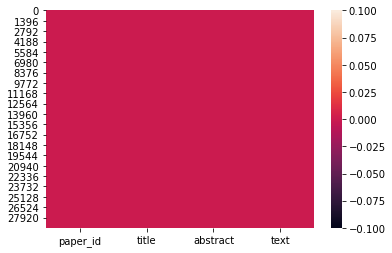

In [23]:
sns.heatmap(corona_df.isnull());

In [24]:
corona_df.shape

(29315, 4)

In [25]:
len(corona_df[corona_df['paper_id'] == ''])

0

In [26]:
len(corona_df[corona_df['title'] == ''])

3583

In [27]:
len(corona_df[corona_df['abstract'] == ''])

8051

In [28]:
len(corona_df[corona_df['text'] == ''])

0

In [29]:
corona_df = corona_df[corona_df['title'] != '']

In [30]:
corona_df = corona_df[corona_df['abstract'] != '']

In [31]:
corona_df.shape

(20343, 4)

## Valores duplicados

In [32]:
corona_df.drop_duplicates(['abstract', 'text', 'title'], inplace = True)

In [33]:
corona_df.shape

(20211, 4)

## Amostra da base de dados

In [34]:
corona_df = corona_df.sample(n = 500, random_state=1)

In [35]:
corona_df.shape

(500, 4)

In [36]:
corona_df.head()

,paper_id,title,abstract,text
7507,b890aa8cb8a15fec0f4bb8e970f5a21fd2dfda33,BMC Veterinary Research Loop-mediated isotherm...,Background: Enteric Redmouth (ERM) disease als...,Yersiniosis or enteric red mouth disease (ERM)...
9101,e572a3a154399f2b500b0f547a7252c94580acf4,Prediction of High Incidence of Dengue in the ...,Background: Accurate prediction of dengue inci...,Dengue fever is a common human viral disease t...
1025,03dce266594748330a10d2d11dbe611bf42aa42d,"MINI REVIEW Rhinovirus Biology, Antigenic Dive...",Human rhinovirus (HRV) remains a leading cause...,Human rhinoviruses (HRVs) are respiratory viru...
7792,c13377750d32446f66a4bcd0bb2da626e4b2a035,Pilgrims and MERS-CoV: what's the risk?,The risk of Middle East Respiratory Syndrome C...,"A decade after SARS, another coronavirus assoc..."
738,db142fe07544dcf0e454f8a9f39452f0aa92a6ca,Kidney impairment is associated with in-hospit...,Background: Information on kidney impairment i...,"In December 2019, a series of unknown origins ..."


In [37]:
corona_df.tail()

,paper_id,title,abstract,text
23234,c7f00c1af00cd27223dd8cb5020788e4e06e48cc,"Design, synthesis, and evaluation of trifluoro...",A series of trifluoromethyl ketones as SARS-Co...,Severe acute respiratory syndrome-associated c...
155,2e7c17caecfe67b64f9b59df404f0761df96987f,National and Regional Influenza-Like-Illness F...,Health planners use forecasts of key metrics a...,Basic model 98 The DICE package has been desig...
21344,aabe5fd7d75d19ba4daca67de64e0b2db4a05d6e,Synthesis of fluorinated acyclic nucleoside ph...,With respect to the strong antiviral activity ...,The chemistry of acyclic nucleoside phosphonat...
19815,938a53e7f870ea74d6347fe145f7ec1d9c657aaf,Liver STRUCTURE AND FUNCTION,The hepatic lobule is the anatomic unit of the...,The basic elements of the biliary tract are th...
21203,a89de2302bef8efe03fb937119e00142397a2083,Infectious diseases in large-scale cat hoardin...,Animal hoarders accumulate animals in over-cro...,Animal hoarding is a complex human and animal ...


In [39]:
sample_text = corona_df['text'][155]
sample_text

ion. In this 102 scenario, the rate at which a susceptible person in region j becomes infectious (that is 103 transitions to the I compartment in region j) depends on: (1) the risk of infection from 104 those in the same region j, (2) the risk of infection from infected people from region i 105 who traveled to region j, and (3) the risk of infection encountered when traveling from 106 region j to region i. To account for the three mechanisms of transmission, ref [24] 107 defined the force of infection, or the average rate that susceptible individuals in region i 108 become infected per time step as:\n where D is the total number of regions. In our case, unlike reference [24] , the 110 transmissibility is not the same for all regions and it is allowed to depend on time: β j (t). 111\n Given this force of infection we can write the coupled S-I-R equations for each region as:\n in the mobility matrix is one and in the limit of no mobility between regions the mobility matrix m ij is the id

## Função para pré-processamento

In [40]:
nlp = en_core_sci_md.load(disable=['tagger', 'parser', 'ner'])
nlp.max_length = 2000000

In [41]:
print(spacy.lang.en.stop_words.STOP_WORDS)

{'third', 'everyone', 'has', '‘d', 'ourselves', 'do', 'might', 'whereafter', 'his', 'next', 'on', 'ours', 'less', 'thus', 'fifty', 'really', 'may', 'made', 'being', 'yours', "'re", 'yourself', 'to', 'hers', 'other', 'however', 'along', 'were', 'thereafter', 'with', 'those', 'why', 'though', 'whether', 'below', 'no', 'cannot', 'ten', 'twenty', 'itself', 'becomes', 'others', 'former', 'go', 'when', 'n‘t', 'becoming', 'throughout', 'meanwhile', 'else', 'there', 'anything', 'should', 'been', 'as', 'how', 'four', 'various', 'down', 'never', 'thereupon', 'them', 'because', 'latterly', 'towards', 'nine', "'ve", 'n’t', 'very', 'him', 'together', '‘ll', 'used', 'give', 'much', 'neither', 'under', 'themselves', 'before', 'although', 'whole', 'nobody', 'become', 'are', 'could', 'by', 'from', 'your', 'wherever', '‘s', 'not', 'then', 'seemed', 'due', 'back', 'across', 'about', 'an', 'many', 'me', 'here', 'for', 'i', 'seem', "'d", 'last', 'whereas', "'m", 'herself', 'was', '’re', 'whom', 'enough', '

In [42]:
len(spacy.lang.en.stop_words.STOP_WORDS)

326

In [43]:
new_stop_words = ['et', 'al', 'doi', 'copyright', 'http', 'https', 'fig', 'table', 'result', 'show']
for word in new_stop_words:
  nlp.vocab[word].is_stop = True

In [45]:
def spacy_tokenizer(sentence):
  sentence = sentence.lower()
  list = []
  list = [word.lemma_ for word in nlp(sentence) if not (word.is_stop or
                                                        word.like_num or
                                                        word.is_punct or
                                                        word.is_space or
                                                        len(word) == 1)]
  list = ' '.join([str(element) for element in list])

  return list

In [46]:
sample_text

ion. In this 102 scenario, the rate at which a susceptible person in region j becomes infectious (that is 103 transitions to the I compartment in region j) depends on: (1) the risk of infection from 104 those in the same region j, (2) the risk of infection from infected people from region i 105 who traveled to region j, and (3) the risk of infection encountered when traveling from 106 region j to region i. To account for the three mechanisms of transmission, ref [24] 107 defined the force of infection, or the average rate that susceptible individuals in region i 108 become infected per time step as:\n where D is the total number of regions. In our case, unlike reference [24] , the 110 transmissibility is not the same for all regions and it is allowed to depend on time: β j (t). 111\n Given this force of infection we can write the coupled S-I-R equations for each region as:\n in the mobility matrix is one and in the limit of no mobility between regions the mobility matrix m ij is the id

In [47]:
test = '1 ' + sample_text
test

ion. In this 102 scenario, the rate at which a susceptible person in region j becomes infectious (that is 103 transitions to the I compartment in region j) depends on: (1) the risk of infection from 104 those in the same region j, (2) the risk of infection from infected people from region i 105 who traveled to region j, and (3) the risk of infection encountered when traveling from 106 region j to region i. To account for the three mechanisms of transmission, ref [24] 107 defined the force of infection, or the average rate that susceptible individuals in region i 108 become infected per time step as:\n where D is the total number of regions. In our case, unlike reference [24] , the 110 transmissibility is not the same for all regions and it is allowed to depend on time: β j (t). 111\n Given this force of infection we can write the coupled S-I-R equations for each region as:\n in the mobility matrix is one and in the limit of no mobility between regions the mobility matrix m ij is the id

In [48]:
result = spacy_tokenizer(test)
result

'basic model die package design implement meta-population epidemic model arbitrary spatial scale couple region model couple spatial region follow ref assume system couple s-i-r equation susceptible-infectious-recovered spatial region scenario rate susceptible person region infectious transition compartment region depend risk infection region risk infection infect people region travel region risk infection encounter travel region region i. account mechanism transmission ref define force infection average rate susceptible individual region infect time step total numb region case unlike reference transmissibility region allow depend time give force infection write couple s-i-r equation region mobility matrix limit mobility region mobility matrix ij identity matrix ii ni recover familiar uncouple s-i-r equation level interaction spatial region determine mobility matrix interaction kernel κ(r ij kernel expect depend geographic distance region ij follow mill riley use variation off-set power

In [49]:
corona_df['text'] = corona_df['text'].apply(spacy_tokenizer)

In [50]:
print(sample_text)

ctious-recovered) for each spatial region. In this 102 scenario, the rate at which a susceptible person in region j becomes infectious (that is 103 transitions to the I compartment in region j) depends on: (1) the risk of infection from 104 those in the same region j, (2) the risk of infection from infected people from region i 105 who traveled to region j, and (3) the risk of infection encountered when traveling from 106 region j to region i. To account for the three mechanisms of transmission, ref [24] 107 defined the force of infection, or the average rate that susceptible individuals in region i 108 become infected per time step as:
 where D is the total number of regions. In our case, unlike reference [24] , the 110 transmissibility is not the same for all regions and it is allowed to depend on time: β j (t). 111
 Given this force of infection we can write the coupled S-I-R equations for each region as:
 in the mobility matrix is one and in the limit of no mobility between regions

In [51]:
len(sample_text)

20312

In [53]:
print(corona_df['text'][155])

basic model die package design implement meta-population epidemic model arbitrary spatial scale couple region model couple spatial region follow ref assume system couple s-i-r equation susceptible-infectious-recovered spatial region scenario rate susceptible person region infectious transition compartment region depend risk infection region risk infection infect people region travel region risk infection encounter travel region region i. account mechanism transmission ref define force infection average rate susceptible individual region infect time step total numb region case unlike reference transmissibility region allow depend time give force infection write couple s-i-r equation region mobility matrix limit mobility region mobility matrix ij identity matrix ii ni recover familiar uncouple s-i-r equation level interaction spatial region determine mobility matrix interaction kernel κ(r ij kernel expect depend geographic distance region ij follow mill riley use variation off-set power 

In [54]:
len(corona_df['text'][155])

11425

# Termos frequentes

In [55]:
for index, row in corona_df.iterrows():
  print(row['paper_id'], row['title'])
  text_file = open('corpus/' + row['paper_id'] + '.txt', 'w')
  n = text_file.write(row['text'])
  text_file.close()

b890aa8cb8a15fec0f4bb8e970f5a21fd2dfda33 BMC Veterinary Research Loop-mediated isothermal amplification as an emerging technology for detection of Yersinia ruckeri the causative agent of enteric red mouth disease in fish


FileNotFoundError: [Errno 2] No such file or directory: 'corpus/b890aa8cb8a15fec0f4bb8e970f5a21fd2dfda33.txt'

In [ ]:
from nltk.corpus import PlaintextCorpusReader
corpus = PlaintextCorpusReader('corpus', '.*')

In [ ]:
files = corpus.fileids()

In [ ]:
files[0]

In [ ]:
corpus.raw('00b88130d2a7c8489e209742494303b6731d7544.txt')

In [ ]:
words = corpus.words()
print(words)

In [ ]:
len(words)

In [ ]:
frequency = nltk.FreqDist(words)
most_common = frequency.most_common(100)
most_common

# Nuvem de palavras

In [ ]:
from matplotlib.colors import ListedColormap
color_map = ListedColormap(['orange', 'green', 'red', 'magenta'])

In [ ]:
from wordcloud import WordCloud
cloud = WordCloud(background_color = 'white', max_words=100, colormap=color_map)

In [ ]:
cloud = cloud.generate(corona_df['text'].str.cat(sep='\n'))
plt.figure(figsize=(15,15))
plt.imshow(cloud)
plt.axis('off')
plt.show()

In [ ]:
corona_df.to_csv('corona_df.csv')

# Extração de entidades nomeadas

## Testes com a função

In [ ]:
text = str(corona_df['text'][10644])
print(text)

In [ ]:
nlp_ent = spacy.load('en')
nlp_ent.max_length = 2000000

In [ ]:
doc = nlp_ent(text)

In [ ]:
for entity in doc.ents:
  if entity.label_ == 'NORP' or entity.label_ == 'GPE':
    print(entity.text, entity.label_)

In [ ]:
from spacy import displacy
displacy.render(doc, style = 'ent', jupyter = True)

## Contagem das entidades na base de dados

In [ ]:
gpe = []
for index, row in corona_df.iterrows():
  text = row['text']
  doc = nlp_ent(text)
  for entity in doc.ents:
    if entity.label_ == 'GPE':
      gpe.append(str(entity.text))

In [ ]:
print(gpe)

In [ ]:
values_gpe, counts_gpe = np.unique(np.array(gpe), return_counts = True)

In [ ]:
gpe_df = pd.DataFrame({'value': values_gpe, 'counts': counts_gpe})

In [ ]:
gpe_df.head()

In [ ]:
gpe_df.shape

In [ ]:
gpe_df_filtered = gpe_df[gpe_df.counts > 50]

In [ ]:
gpe_df_filtered.shape

In [ ]:
gpe_df_filtered.head(16)

In [ ]:
sns.set(rc={'figure.figsize': (15,8)})
sns.barplot(x = 'value', y = 'counts', hue='value', data=gpe_df_filtered);

# Textos utilizados para pesquisa

## What do we know about COVID-19 risk factors?

- Smoking, 
- pre-existing pulmonary disease
- Co-infections (determine whether co-existing respiratory/viral infections make the virus more transmissible or virulent) and other - co-morbidities
- Neonates and pregnant women
- Socio-economic and behavioral factors to understand the economic impact of the virus and whether there were differences

## What do we know about non-pharmaceutical interventions?

- Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases.
Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments.




# Pesquisa com uma palavra e NLTK

In [ ]:
text = nltk.Text(corpus.words())

In [ ]:
match = text.concordance('pulmonary', width = 150, lines=30)

In [ ]:
type(match)

# Pesquisa com uma palavra e "find"

## Testando o método "find"

In [ ]:
string = 'spread wuhan city china infect traveller cause sporadic secondary transmission city secondary city epidemic'
search_string = 'city'

In [ ]:
print(string.find(search_string))

In [ ]:
string[13]

In [ ]:
string[13:13+10]

In [ ]:
string[13-10:13]

In [ ]:
string[13:13+10000]

In [ ]:
# Código baseado em: https://www.journaldev.com/23666/python-string-find
def find_texts(input_str, search_str, number_of_words):
  l = []
  index = 0
  number_of_words = number_of_words
  while index < len(input_str):
    i = input_str.find(search_str, index)
    if i == -1:
      return l
    
    if input_str[i-number_of_words:i] == '':
      start = 0
    else:
      start = i - number_of_words

    l.append(input_str[start:i] + input_str[i:i+number_of_words])
    index = i + 1
  return l

In [ ]:
texts = find_texts(string, search_string, 50)
texts

In [ ]:
display(HTML(f'<h1>{search_string.upper()}</h1>'))
display(HTML(f"""<p><strong>Number of matches:</strong> {len(texts)}</p>"""))
for i in texts:
  #print(i)
  marked_text = str(i.replace(search_string, f"<mark>{search_string}</mark>"))
  #print(marked_text)
  display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))

## Aplicação na base de dados

In [ ]:
search_string = 'pulmonary disease'

In [ ]:
search_string = spacy_tokenizer(search_string)
search_string

In [ ]:
def find_all_texts(input_str, search_str, number_of_words):
  text_list = []
  index = 0
  number_of_words = number_of_words
  while index < len(input_str):
    i = input_str.find(search_str, index)
    if i == -1:
      return text_list
    
    if input_str[i-number_of_words:i] == '':
      start = 0
    else:
      start = i - number_of_words

    text_list.append(input_str[start:i] + input_str[i:i+number_of_words])
    index = i + 1
  return text_list

In [ ]:
documents = []
for index, row in corona_df.iterrows():
  documents.append(find_all_texts(row['text'], search_string, 40))

In [ ]:
len(documents)

In [ ]:
for doc in documents:
  if doc != []:
    print(doc)

In [ ]:
for index, row in corona_df.iterrows():
  texts = find_all_texts(row['text'], search_string, 400)
  if texts == []:
    continue
  
  paper_id = row['paper_id']
  title = row['title']
  display(HTML(f'<h1>{search_string.upper()}</h1>'))
  display(HTML(f"""<p>
                      <strong>Title:</strong> {title}</br>
                      <strong>ID:</strong> {paper_id}</br>
                      <strong>Number of matches:</strong> {len(texts)}
                   </p>"""))
  for i in texts:
    marked_text = str(i.replace(search_string, f"<mark>{search_string}</mark>"))
    display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))  


Vantagens
- Rápido
- Fácil implementação
- Muito útil para pesquisas simples com uma palavra
- Bom para palavras-chave

Desvantagens
- Somente uma palavra-chave
- Não possui ordenação de importância
- Considera somente a palavra "completa"

# Pesquisa com mais palavras e spaCy

## Testando o spaCy

In [ ]:
string = 'spread wuhan city china infect traveller cause sporadic secondary transmission city secondary city epidemic'

In [ ]:
search_strings = ['city', 'traveller']
tokens_list = [nlp(item) for item in search_strings]

In [ ]:
tokens_list

In [ ]:
print(nlp.vocab)

In [ ]:
from spacy.matcher import PhraseMatcher
matcher = PhraseMatcher(nlp.vocab)
matcher.add('SEARCH', None, *tokens_list)

In [ ]:
doc = nlp(string)
matches = matcher(doc)
matches

In [ ]:
doc[2:3]

In [ ]:
doc[5:6]

In [ ]:
doc[10:11]

In [ ]:
doc[12:13]

In [ ]:
doc[10-5:10+5]

In [ ]:
matches[0]

In [ ]:
matches[0][1]

In [ ]:
matches[0][2]

In [ ]:
doc[matches[0][1]:matches[0][2]]

## Aplicação na base de dados

In [ ]:
search_strings = ['smoking', 'pulmonary disease']
tokens_list = [nlp(spacy_tokenizer(item)) for item in search_strings]
tokens_list

In [ ]:
from spacy.matcher import PhraseMatcher
matcher = PhraseMatcher(nlp.vocab)
matcher.add('SEARCH', None, *tokens_list)
number_of_words = 50

In [ ]:
search_strings_html = ' '.join([str(element) for element in search_strings])
search_strings_html

In [ ]:
for index, row in corona_df.iterrows():
  marked_text = ''
  doc = nlp(row['text'])
  paper_id = row['paper_id']
  title = row['title']
  matches = matcher(doc)
  if matches == []:
    continue

  display(HTML(f'<h1>{search_strings_html.upper()}</h1>'))
  display(HTML(f"""<p>
                      <strong>Title:</strong> {title}</br>
                      <strong>ID:</strong> {paper_id}</br>
                      <strong>Number of matches:</strong> {len(matches)}
                   </p>"""))
  for i in matches:
    start = i[1] - number_of_words
    if start < 0:
      start = 0
    for j in range(len(tokens_list)):
      if doc[i[1]:i[2]].similarity(tokens_list[j]) == 1.0:
        search_text = str(tokens_list[j])
        marked_text += str(doc[start:i[2] + number_of_words]).replace(search_text, f"<mark>{search_text}</mark>")
        marked_text += "<br /><br />"
  display(HTML(f"""<blockquote>... {marked_text} ...</blockquote>"""))

Vantagens
- Fácil implementação
- Muito útil para pesquisas simples com mais palavras
- Bom para palavras-chave
- Usa uma biblioteca própria para processamento de linguagem natural

Desvantagens
- Não possui ordenação de importância

# Similaridade entre strings com fuzzywuzzy

- Distância Levenshtein: https://pt.wikipedia.org/wiki/Dist%C3%A2ncia_Levenshtein

## Testes com o fuzzywuzzy

In [ ]:
!pip install fuzzywuzzy

In [ ]:
!pip install python-Levenshtein

In [ ]:
from fuzzywuzzy import fuzz

In [ ]:
# Similaridade da string em ordem
fuzz.ratio('Apple Inc.', 'Apple')

In [ ]:
# Similaridade da string parcial
fuzz.partial_ratio('Apple Inc.', 'Apple')

In [ ]:
# Ignora a ordem das palavras
fuzz.token_sort_ratio('Lakers x Chigaco Bulls', 'Chigago Bulls x Lakers')

In [ ]:
# Ignora palavras duplicadas
fuzz.token_set_ratio('Today we have a great game: Lakers x Chigago Bulls', 'Chicago Bulls x Lakers')

## Comparação com o texto completo

In [ ]:
search_string = 'Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases. Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments'

In [ ]:
search_string = spacy_tokenizer(search_string)
print(search_string)

In [ ]:
ratio = []
partial_ratio = []
sort_ratio = []
set_ratio = []
for index, row in corona_df.iterrows():
  ratio.append(fuzz.ratio(row['text'], search_string))
  partial_ratio.append(fuzz.partial_ratio(row['text'], search_string))
  sort_ratio.append(fuzz.token_sort_ratio(row['text'], search_string))
  set_ratio.append(fuzz.token_set_ratio(row['text'], search_string))

In [ ]:
len(ratio)

In [ ]:
np.array(ratio).mean()

In [ ]:
np.array(partial_ratio).mean()

In [ ]:
np.array(sort_ratio).mean()

In [ ]:
np.array(set_ratio).mean()

## Comparação com o abstract

In [ ]:
corona_df.head()

In [ ]:
corona_df['abstract'] = corona_df['abstract'].apply(spacy_tokenizer)

In [ ]:
corona_df.head()

In [ ]:
ratio = []
partial_ratio = []
sort_ratio = []
set_ratio = []
for index, row in corona_df.iterrows():
  ratio.append(fuzz.ratio(row['abstract'], search_string))
  partial_ratio.append(fuzz.partial_ratio(row['abstract'], search_string))
  sort_ratio.append(fuzz.token_sort_ratio(row['abstract'], search_string))
  set_ratio.append(fuzz.token_set_ratio(row['abstract'], search_string))

In [ ]:
np.array(ratio).mean()

In [ ]:
np.array(partial_ratio).mean()

In [ ]:
np.array(sort_ratio).mean()

In [ ]:
np.array(set_ratio).mean()

## Retorno dos artigos mais similares

In [ ]:
scores = {}
for index, row in corona_df.iterrows():
  scores[row['paper_id']] = fuzz.token_set_ratio(row['text'], search_string)

In [ ]:
print(scores)

In [ ]:
scores['532f2c636fca1caae1f23885b9dc0e3302a0afd5']

In [ ]:
import operator
sorted_scores = sorted(scores.items(), key=operator.itemgetter(1), reverse = True)

In [ ]:
sorted_scores[0:10]

In [ ]:
corona_df.loc[corona_df['paper_id'] == '68a7101a90454172c91785d8c352f776a82df5d4']

In [ ]:
pd.set_option('display.max_colwidth', -1)
display(HTML(f'<h4>{search_string.upper()}</h4>'))
for i in sorted_scores[:10]:
  df = corona_df.loc[corona_df['paper_id'] == i[0]]
  display(HTML(f"""<p>
                      <strong>Title:</strong> {df['title']}</br>
                      <strong>ID:</strong> {i[0]}</br>
                      <strong>Score:</strong> {i[1]}</br>
                      <strong>Abstract:</strong> {str(df['abstract'])[0:700]}
                   </p>"""))

Vantagens
- Biblioteca com várias funções
- Útil tanto para pesquisas por palavras-chave quanto para textos maiores
- Notas de acordo com a importância

Desvantagens
- Modelo de cálculo matemático não é muito adequado

# Documentos similares com TF-IDF e similaridade do cosseno

### TF-IDF (Term frequency - inverse document frequency)

- Redimensionar a frequência das palavras pela frequência com que aparecem em todos os documentos
- **Term frequency (TF)**: frequência da palavra no documento atual - TF = (número de vezes que o termo **t** aparece no documento) / (número de termos no documento)
- **Inverse document frequency (IDF)**: quão rara é a palavra nos documentos - IDF = log(N/n), **N** é o número de documentos e **n** é o número de documentos que o termo **t** apareceu
- **TF-IDF**: importância de uma palavra para um documento em uma coleção ou corpus

- Considerando um documento com 100 palavras no qual a palavra cachorro aparece 5 vezes
- TF = 5 / 100 = 0.05
- Temos 100 documentos no total (N) e a palavra cachorro aparece aparece em 20 desses documentos (n)
- IDF = log(100 / 20) = 0.69
- TF-IDF = 0.05 * 0.69 = 0.034

- Quanto maior o valor do peso, mais raro é o termo. Quanto menor o peso, mais comum é o termo

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

In [ ]:
texts = corona_df['text'][:3].tolist()
texts

In [ ]:
texts.append(texts[0])
texts

In [ ]:
tfidf = TfidfVectorizer()
vectorized = tfidf.fit_transform(texts)

In [ ]:
type(vectorized)

In [ ]:
print(tfidf.get_feature_names())

In [ ]:
len(tfidf.get_feature_names())

In [ ]:
print(tfidf.vocabulary_)

In [ ]:
print(tfidf.idf_)

In [ ]:
vectorized

In [ ]:
vectorized.todense()

In [ ]:
vectorized.todense().shape

## Similaridade do cosseno

- Link: https://en.wikipedia.org/wiki/Cosine_similarity
- Cálculos passo a passo: https://janav.wordpress.com/2013/10/27/tf-idf-and-cosine-similarity/
- Temos duas matrizes: TF e IDF
- Cosine Similarity (d1, d2) =  Dot product(d1, d2) / ||d1|| * ||d2||

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

In [ ]:
vectorized[0].todense()

In [ ]:
cosine_similarity(vectorized[0], vectorized[1])

In [ ]:
cosine_similarity(vectorized[0], vectorized[3])

In [ ]:
similarity = cosine_similarity(vectorized[0], vectorized)
similarity

## TF-IDF e similaridade do coseno na base de dados

In [ ]:
texts = corona_df['text'].tolist()

In [ ]:
texts[:10]

In [ ]:
len(texts)

In [ ]:
tfidf = TfidfVectorizer()
vectorized = tfidf.fit_transform(texts)

In [ ]:
vectorized

In [ ]:
search_string = 'Guidance on ways to scale up NPIs in a more coordinated way (e.g., establish funding, infrastructure and authorities to support real time, authoritative (qualified participants) collaboration with all states to gain consensus on consistent guidance and to mobilize resources to geographic areas where critical shortfalls are identified) to give us time to enhance our health care delivery system capacity to respond to an increase in cases. Rapid design and execution of experiments to examine and compare NPIs currently being implemented. DHS Centers for Excellence could potentially be leveraged to conduct these experiments'

In [ ]:
search_string = spacy_tokenizer(search_string)
print(search_string)

In [ ]:
search_string_vectorized = tfidf.transform([search_string])

In [ ]:
search_string_vectorized

In [ ]:
similarity = cosine_similarity(search_string_vectorized, vectorized)
similarity

In [ ]:
len(similarity[0])

In [ ]:
scores_dict = {}
for i in range(len(similarity[0])):
  scores_dict[i] = similarity[0][i]

In [ ]:
print(scores_dict)

In [ ]:
import operator
sorted_scores = sorted(scores_dict.items(), key=operator.itemgetter(1), reverse=True)

In [ ]:
print(sorted_scores)

In [ ]:
display(HTML(f'<h4>{search_string.upper()}</h4>'))
for i in sorted_scores[:10]:
  df = corona_df.iloc[i[0]]

  display(HTML(f"""<p>
                      <strong>Title:</strong> {df['title']}</br>
                      <strong>ID:</strong> {df['paper_id']}</br>
                      <strong>Score:</strong> {i[1]}</br>
                      <strong>Abstract:</strong> {str(df['abstract'][0:700])}
                   </p></br>"""))

# Agrupamento dos artigos

## Tratamento da base de dados

In [ ]:
corona_df_completo = pd.read_csv('/content/gdrive/My Drive/corona_df_completo.csv')

In [ ]:
corona_df_completo.shape

In [ ]:
corona_df_completo = corona_df_completo.dropna()

In [ ]:
corona_df_completo.shape

In [ ]:
pd.set_option('display.max_colwidth', 100)
corona_df_completo.head()

## TF-IDF

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
dataset_texts = corona_df_completo['text'].tolist()

In [ ]:
len(dataset_texts)

In [ ]:
2**12

In [ ]:
tfidf = TfidfVectorizer(max_features=2**12)
vectorized = tfidf.fit_transform(dataset_texts)
vectorized

## Redução de dimensionalidade

In [ ]:
from sklearn.decomposition import PCA
pca = PCA(n_components = 2)
X_pca = pca.fit_transform(vectorized.toarray())

In [ ]:
X_pca.shape

In [ ]:
components = pca.explained_variance_ratio_
components

In [ ]:
sns.set(rc={'figure.figsize': (10,8)})
sns.scatterplot(X_pca[:,0], X_pca[:, 1])
plt.title('Covid-19 Papers');

## Definição do número de clusters

- Fast K-means: https://www.researchgate.net/publication/51929167_Fast_K-Means_Algorithm_Clustering

In [ ]:
from sklearn.cluster import MiniBatchKMeans

In [ ]:
wcss = []
for i in range(1, 21):
  kmeans = MiniBatchKMeans(n_clusters = i, random_state = 0)
  kmeans.fit(vectorized)
  wcss.append(kmeans.inertia_)
plt.plot(range(1, 21), wcss)
plt.xlabel('Number of clusters')
plt.ylabel('WCSS')

## Agrupamento com k-means

In [ ]:
k = 5
kmeans = MiniBatchKMeans(n_clusters=k)
y_pred = kmeans.fit_predict(vectorized)

In [ ]:
np.unique(y_pred)

In [ ]:
len(y_pred)

In [ ]:
palette = sns.color_palette('bright', len(set(y_pred)))
sns.scatterplot(X_pca[:,0], X_pca[:, 1], hue=y_pred, legend='full', palette=palette)
plt.title('Clustered Covid-19 Papers');

## Visualização dos resultados

In [ ]:
# Based on: https://www.kaggle.com/maksimeren/covid-19-literature-clustering

from bokeh.models import ColumnDataSource, HoverTool, LinearColorMapper, CustomJS
from bokeh.palettes import Category20
from bokeh.transform import linear_cmap
from bokeh.io import output_file, show
from bokeh.transform import transform
from bokeh.io import output_notebook
from bokeh.plotting import figure
from bokeh.layouts import column
from bokeh.models import RadioButtonGroup
from bokeh.models import TextInput
from bokeh.layouts import gridplot
from bokeh.models import Div
from bokeh.models import Paragraph
from bokeh.layouts import column, widgetbox

output_notebook()
y_labels = y_pred

# data sources
source = ColumnDataSource(data=dict(
    x= X_pca[:,0], 
    y= X_pca[:,1],
    x_backup = X_pca[:,0],
    y_backup = X_pca[:,1],
    desc= y_labels, 
    titles= corona_df_completo['title'],
    abstract = corona_df_completo['abstract'],
    labels = ["C-" + str(x) for x in y_labels]
    ))

# hover over information
hover = HoverTool(tooltips=[
    ("Title", "@titles{safe}"),
    ("Abstract", "@abstract{safe}"),
],
                 point_policy="follow_mouse")

# map colors
mapper = linear_cmap(field_name='desc', 
                     palette=Category20[20],
                     low=min(y_labels) ,high=max(y_labels))

# prepare the figure
p = figure(plot_width=800, plot_height=800, 
           tools=[hover, 'pan', 'wheel_zoom', 'box_zoom', 'reset'], 
           title="Covid-19 Papers", 
           toolbar_location="right")

# plot
p.scatter('x', 'y', size=5, 
          source=source,
          fill_color=mapper,
          line_alpha=0.3,
          line_color="black",
          legend = 'labels')

# add callback to control 
callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var radio_value = cb_obj.active;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            labels = data['desc'];
            
            if (radio_value == '20') {
                for (i = 0; i < x.length; i++) {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                }
            }
            else {
                for (i = 0; i < x.length; i++) {
                    if(labels[i] == radio_value) {
                        x[i] = x_backup[i];
                        y[i] = y_backup[i];
                    } else {
                        x[i] = undefined;
                        y[i] = undefined;
                    }
                }
            }


        source.change.emit();
        """)

# callback for searchbar
keyword_callback = CustomJS(args=dict(p=p, source=source), code="""
            
            var text_value = cb_obj.value;
            var data = source.data; 
            
            x = data['x'];
            y = data['y'];
            
            x_backup = data['x_backup'];
            y_backup = data['y_backup'];
            
            abstract = data['abstract'];
            titles = data['titles'];
            
            for (i = 0; i < x.length; i++) {
                if(abstract[i].includes(text_value) || 
                   titles[i].includes(text_value)  {
                    x[i] = x_backup[i];
                    y[i] = y_backup[i];
                } else {
                    x[i] = undefined;
                    y[i] = undefined;
                }
            }
        source.change.emit();
        """)

# option
option = RadioButtonGroup(labels=["C-0", "C-1", "C-2",
                                  "C-3", "C-4", "C-5",
                                  "C-6", "C-7", "C-8",
                                  "C-9", "C-10", "C-11",
                                  "C-12", "C-13", "C-14",
                                  "C-15", "C-16", "C-17",
                                  "C-18", "C-19", "All"], 
                          active=20, callback=callback)

# search box
keyword = TextInput(title="Search:", callback=keyword_callback)

#header
header = Div(text="""<h1>Covid-19 Papers</h1>""")

# show
show(column(header, widgetbox(option, keyword),p))

# Sumarização dos textos

## Testes com a função

In [ ]:
corona_df_original = pd.read_csv('/content/gdrive/My Drive/corona_df_original.csv')

In [ ]:
corona_df_original.shape

In [ ]:
corona_df_original.head()

In [ ]:
!pip install bert-extractive-summarizer

In [ ]:
from summarizer import Summarizer

In [ ]:
text = str(corona_df_original['text'][0])
print(text)

In [ ]:
len(text)

In [ ]:
model = Summarizer()

In [ ]:
result = model(text)

In [ ]:
result

In [ ]:
result = ''.join(result)
print(result)

In [ ]:
len(result)